# Deep Learning MLAI Project

# Importing Relevant Libraries 

In [6]:
#Model Building
import tensorflow as tf
from tensorflow.keras.layers import Flatten, Dense, Dropout
from tensorflow.keras import datasets, layers, models
from tensorflow.keras.models import Model
from tensorflow.keras import datasets

#Data Visualization
from sklearn.metrics import confusion_matrix, classification_report
from tensorflow.keras.callbacks import TensorBoard
from IPython.display import display_html, display, HTML
%load_ext tensorboard
%matplotlib inline

#Data Augmentation
from tensorflow.keras.preprocessing.image import ImageDataGenerator

#Pre-trained Models
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.xception import Xception

#Other Relevant Libraries
from PIL import Image
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import random
import cv2
import os
import time

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [7]:
print(tf. __version__) 

2.1.0


# Step 1. Dataset Preperations

Lets make sure that the data collected is suitable. First lets import our data by specifying our data directories. Next lets loop through eash image and check if the image can be opned.

In [5]:
#Import Data Directory
train_dir = "D:/muu/train"
test_dir =  "D:/muu/test"

#Classes
classes = ['Mushroom', 'Uni', 'Unknown']

#Input Reseloution
IMG_HEIGHT = 150
IMG_WIDTH = 150

#Check Dataset
folder_path = train_dir
extensions = []

# for fldr in os.listdir(folder_path):
#     sub_folder_path = os.path.join(folder_path, fldr)
#     for filee in os.listdir(sub_folder_path):
#         file_path = os.path.join(sub_folder_path, filee)
#         print('** Path: {}  **'.format(file_path), end="\r", flush=True)
#         im = Image.open(file_path)
#         rgb_im = im.convert('RGB')
#         if filee.split('.')[1] not in extensions:
#             extensions.append(filee.split('.')[1])
# print("\n Completed Cheek")

In [6]:
#Function to display data
def visualize_batch(batch):
    n = 15
    num_row, num_col = 3,5
    fig, axes = plt.subplots(num_row, num_col, figsize=(3* num_col, 3* num_row))
    
    for i in range(n):
        img = np.array(batch[0][i] * 255, dtype='uint8')
        ax = axes[i // num_col, i% num_col]
        class_index = np.argmax(train_batch[1][i]) 
        ax.set_xlabel(classes[class_index])
        ax.imshow(img)
        
    plt.tight_layout()
    plt.show()

# Step 1.1 Loading the Dataset

With Tensorflow there are several methods to load our datasets, we chose to use the ImageDataGenerator function. This function  not only allowed us to load the dataset directly from our directory but also perform some basic Data Augmentation, Normalizing and Spliting.

In [25]:
#Dataset Generator (Import and Normalise Data)
train_datagen_da = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255,
    rotation_range = 30,
    zoom_range = 0.2,
    width_shift_range=0.1,
    height_shift_range=0.1,
    validation_split = 0.15
)

test_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255
)

#Create Training Dataset
print("Training Dataset")
train_data = train_datagen_da.flow_from_directory(
    directory= train_dir,
    target_size= (IMG_HEIGHT, IMG_WIDTH),
    class_mode = 'categorical',
    batch_size = 214,
    seed = 69,
    subset="training"
)

#Create Validation Dataset
print("\nValidation Dataset")
valid_data = train_datagen.flow_from_directory(
    directory= train_dir,
    target_size= (IMG_HEIGHT, IMG_WIDTH),
    class_mode = 'categorical',
    batch_size = 214,
    seed = 69,
    subset="validation"
)

#Create Teststing Dataset
print("\nTest Dataset")
test_data = test_datagen.flow_from_directory(
    directory= test_dir,
    target_size= (IMG_HEIGHT, IMG_WIDTH),
    class_mode = 'categorical',
    batch_size = 77,
    seed = 69
)

test_batch = test_data.next()

Training Dataset
Found 1370 images belonging to 3 classes.

Validation Dataset
Found 240 images belonging to 3 classes.

Test Dataset
Found 79 images belonging to 3 classes.


# Step 1.2 Visualizing our loaded Dataset

Now lets us verify that the images were loaded properly. To do this we will use Matplotlib to plot the images from our training batch along with their corresponding labels.

Training Batch Shape : (64, 150, 150, 3)


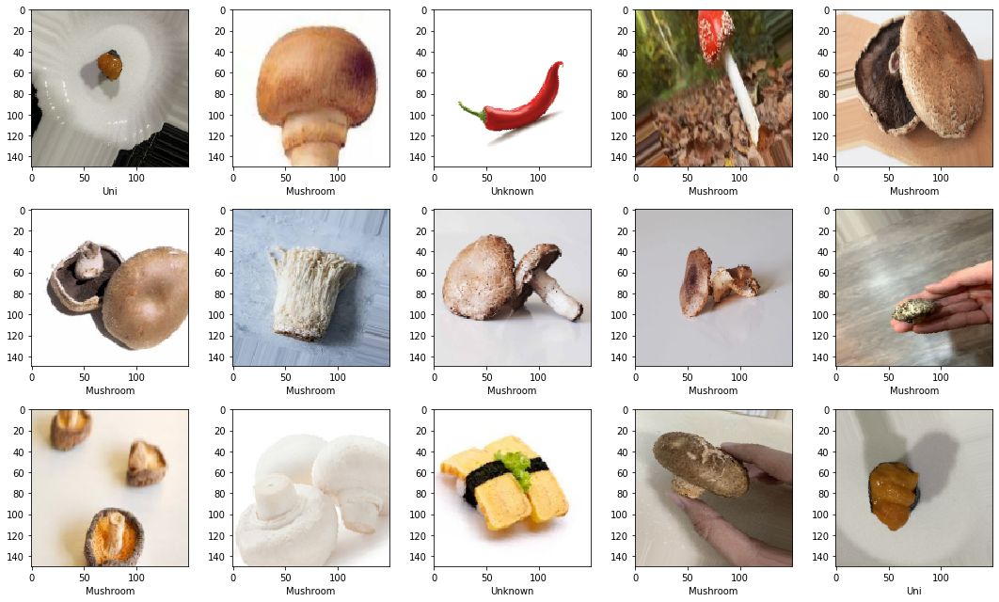

In [10]:
#Visualize our Current Dataset
train_batch = train_data.next()
print(f'Training Batch Shape : {train_batch[0].shape}')
visualize_batch(train_batch)

# Step 2. Building a custom Image Classifier (Transfer Learning)

Transfer Learning is a popular technique used in the space of machine learning. To put it simply, we want to harness the knowledge gained from a previouly trained model and apply it to a a different task. In our scenario we want to use popular pre-trained image reconition models and apply it to our custom dataset. This is done by reusing the previous weights of the model and adding our data over it. We do this by freezing the top layers of the pre-trained model and leaving the last layer for us to modify to fit our use case.

In [6]:
#Function to train a custom model on a pre-trained model -> Adding the final layer
def model_output_for_TL (pre_trained_model, last_output):
    x = Flatten()(last_output)
    # Dense hidden layer
    x = Dense(512, activation='relu')(x)
    x = Dropout(0.2)(x)
    # Output neuron.
    x = Dense(3, activation='softmax')(x)
    model = Model(pre_trained_model.input, x)
    return model

# Step 2.1 IncpetionV3 

InceptionV3 is a popular CNN developed by Google that is 48 layers deep. This model was fed over a million different images and had an input size of 299 by 299. It can classify images into 1000 unique categories, ranging from objects such as keyboard and mice to many types of animals. The end result was a model was able to attain greater than 78.1% top-5 accuracy on the ImageNet Dataset.

In [13]:
#IncpetionV3 Model
pre_trained_model = InceptionV3(
    input_shape = (IMG_HEIGHT, IMG_WIDTH, 3),
    include_top = False,
    weights = 'imagenet'
)

#TensorBoard
NAME = "InceptionV3-{}".format(int(time.time()))
logdir = os.path.join("logs", "fit_pre_trained", NAME)
tensorboard = TensorBoard(logdir) 

# #View layers in InceptionV3
# for layer in pre_trained_model.layers:
#     print(layer.name)
    

#Freezing the layers
for layer in pre_trained_model.layers:
    layer.trainable = False #freeze the layer, frozen layer won’t be updated during training
    
last_layer = pre_trained_model.get_layer('mixed3') #define output as last_layer
last_output = last_layer.output

model_TL_inceptionv3 = model_output_for_TL(pre_trained_model, last_output)
model_TL_inceptionv3.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

#Training the model 
history_TL_inceptionv3 = model_TL_inceptionv3.fit(
    train_data,
    epochs=10,
    verbose=0,
    callbacks=[tensorboard],
    validation_data = valid_data)

  ...
    to  
  ['...']


C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


  ...
    to  
  ['...']


C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


# Step 2.2 VGG-16

VGG-16 is another popular image recontion model, developed by Karen Simonyan and Andrew Zisserman from the University of Oxford in 2014. As the name implies, it 16 layers deeps. Trained on a dataset with over 14 million images beloning to 1000 unique classes. It was able to achieve a 92.7% top-5 test accuracy in the ImageNet dataset.

In [14]:
#VGG16 Model
pre_trained_model = VGG16(
    input_shape = (IMG_HEIGHT, IMG_WIDTH, 3),
    include_top = False,
    weights = 'imagenet'
)

#TensorBoard
NAME = "VGG-16-{}".format(int(time.time()))
logdir = os.path.join("logs", "fit_pre_trained", NAME)
tensorboard = TensorBoard(logdir)

# #View layers in VGG16
# for layer in pre_trained_model.layers:
#     print(layer.name)

#Freezing the layers
for layer in pre_trained_model.layers:
    layer.trainable = False #freeze the layer, frozen layer won’t be updated during training
    
last_layer = pre_trained_model.get_layer('block5_pool') #define output as last_layer
last_output = last_layer.output

model_TL_vgg16 = model_output_for_TL(pre_trained_model, last_output)
model_TL_vgg16.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

#Training the model 
history_TL_vgg16 = model_TL_vgg16.fit(
    train_data,
    epochs=10,
    verbose=1,
    callbacks=[tensorboard],
    validation_data = valid_data)

  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/10
 8/22 [=========>....................] - ETA: 23s - loss: 2.9818 - accuracy: 0.5042

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 54s 2s/step - loss: 1.5322 - accuracy: 0.6255 - val_loss: 0.3795 - val_accuracy: 0.8750
Epoch 2/10
22/22 [==============================] - 52s 2s/step - loss: 0.3084 - accuracy: 0.8861 - val_loss: 0.3422 - val_accuracy: 0.8917
Epoch 3/10
22/22 [==============================] - 64s 3s/step - loss: 0.1816 - accuracy: 0.9445 - val_loss: 0.2965 - val_accuracy: 0.9125
Epoch 4/10
22/22 [==============================] - 56s 3s/step - loss: 0.1107 - accuracy: 0.9686 - val_loss: 0.2459 - val_accuracy: 0.9125
Epoch 5/10
22/22 [==============================] - 52s 2s/step - loss: 0.0758 - accuracy: 0.9847 - val_loss: 0.2452 - val_accuracy: 0.9250
Epoch 6/10
22/22 [==============================] - 52s 2s/step - loss: 0.0513 - accuracy: 0.9920 - val_loss: 0.2498 - val_accuracy: 0.9292
Epoch 7/10
22/22 [==============================] - 51s 2s/step - loss: 0.0412 - accuracy: 0.9927 - val_loss: 0.2156 - val_accuracy: 0.9292
Epoch 8/10
22/22 [=============

# Step 2.3 Xception

Xcpetion is the final model we wil be looking into. Proposed by the creator and cheif maintainer of the Keras library, Francois Chollet. It is 71 layers deeps and was trained on approximately 1.2 million images and addition 50 thousand images validation and 100 thousand for testing. It was able to acheive a 94.5% top-5 accuracy on the IamgeNet dataset.

In [16]:
#Xception Model
pre_trained_model = Xception(
    input_shape = (IMG_HEIGHT, IMG_WIDTH, 3),
    include_top = False,
    weights = 'imagenet'
)

#TensorBoard
NAME = "Xception-{}".format(int(time.time()))
logdir = os.path.join("logs", "fit_pre_trained", NAME)
tensorboard = TensorBoard(logdir)

# #View layers in Xception
# for layer in pre_trained_model.layers:
#     print(layer.name)

#Freezing the layers
for layer in pre_trained_model.layers:
    layer.trainable = False #freeze the layer, frozen layer won’t be updated during training
    
last_layer = pre_trained_model.get_layer('block14_sepconv2_act') #define output as last_layer
last_output = last_layer.output

model_TL_xception = model_output_for_TL(pre_trained_model, last_output)
model_TL_xception.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

#Training the model 
history_TL_xception = model_TL_xception.fit(
    train_data,
    epochs=1,
    verbose=10,
    callbacks=[tensorboard],
    validation_data = valid_data)

  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps


C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


# Step 2.4 Results and evaluation of Trasnfer Learning

To evluate the model we will run predictions on our test dataset. The test dataset is independent from the training dataset, it follows a similar distribution of classes but consist of images that are were not used for training. This allows the model to predict on images that it has never seen before and will help eliminate bias results. 

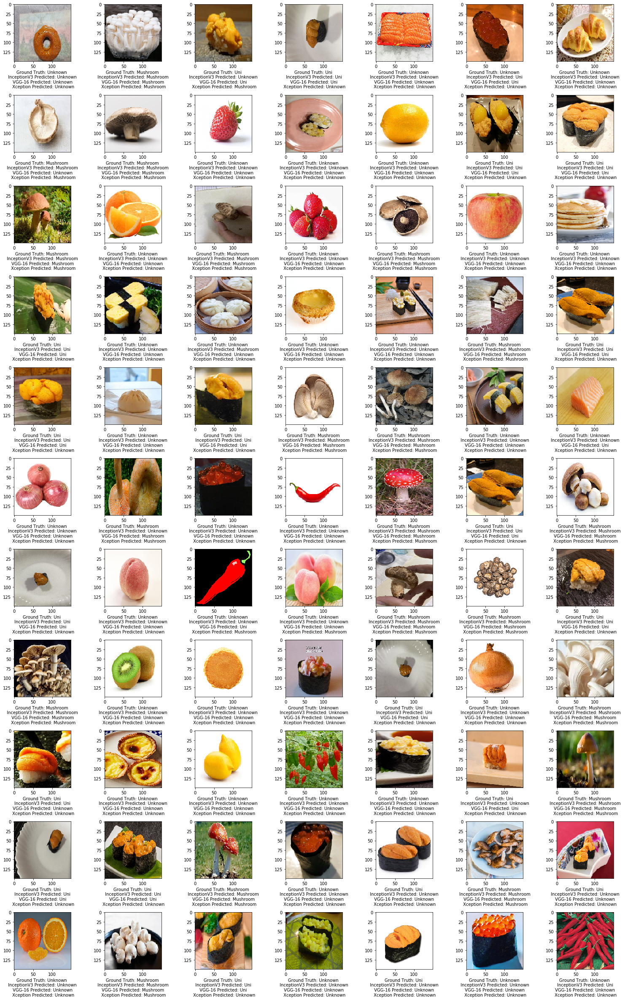

************** Classification Report for IncpetionV3 **************

               precision    recall  f1-score   support

           0       0.95      0.95      0.95        20
           1       0.88      0.75      0.81        20
           2       0.85      0.92      0.88        37

    accuracy                           0.88        77
   macro avg       0.89      0.87      0.88        77
weighted avg       0.88      0.88      0.88        77

77/77 [==============================] - 0s 6ms/sample - loss: 0.3311 - accuracy: 0.8831

 [0.3311123677662441, 0.8831169] 

*******************************************************************

**************** Classification Report for VGG-16 ****************

               precision    recall  f1-score   support

           0       1.00      0.95      0.97        20
           1       0.84      0.80      0.82        20
           2       0.87      0.92      0.89        37

    accuracy                           0.90        77
   macro avg  

C:\Users\Gamepro\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Gamepro\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Gamepro\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 **************** Classification Report Xception ****************

               precision    recall  f1-score   support

           0       0.87      1.00      0.93        20
           1       0.00      0.00      0.00        20
           2       0.65      0.95      0.77        37

    accuracy                           0.71        77
   macro avg       0.51      0.65      0.57        77
weighted avg       0.54      0.71      0.61        77

77/77 [==============================] - 1s 10ms/sample - loss: 8.0218 - accuracy: 0.7143

 [8.021836268437372, 0.71428573] 

*******************************************************************



In [17]:
def visualize_prediction():
    n = 77
    num_row, num_col = 11, 7
    fig, axes = plt.subplots(num_row, num_col, figsize=(3* num_col, 3* num_row))
    
    #Get Prediction Results of each model
    inceptionV3 =   model_TL_inceptionv3.predict(test_batch)
    VGG_predicted = model_TL_vgg16.predict(test_batch)
    xception = model_TL_xception.predict(test_batch)
    
    for i in range(n):
        img = np.array(test_batch[0][i] * 255, dtype='uint8')
        ax = axes[i // num_col, i% num_col]
        
        #Ground Truth
        class_index = np.argmax(test_batch[1][i]) 
        class_index_truth = classes[class_index]
        
        #InceptionV3 Model
        predicted_class_index_inception = np.argmax(inceptionV3[i])
        predicted_class_inception = classes[predicted_class_index_inception]

        #VGG Model
        predicted_class_index_VGG = np.argmax(VGG_predicted[i])
        predicted_class_VGG = classes[predicted_class_index_VGG]
        
        #Xception Model
        predicted_class_index_xception = np.argmax(xception[i])
        predicted_class_xception = classes[predicted_class_index_xception]
        
        
        ax.set_xlabel(f'Ground Truth: {class_index_truth} \n InceptionV3 Predicted: {predicted_class_inception} \n VGG-16 Predicted: {predicted_class_VGG} \n Xception Predicted: {predicted_class_xception}')
        ax.imshow(img)
        
    plt.tight_layout()
    plt.show()
visualize_prediction()

#Classification Report and Metricts of TL Models

#Extract Ground Truth
X_test, y_test = test_batch
y_test_label = [np.argmax(element) for element in y_test]

#IncpetionV3 
y_inceptionv3 = model_TL_inceptionv3.predict(test_batch)
y_inceptionv3_predicted = [np.argmax(element) for element in y_inceptionv3]
print("************** Classification Report for IncpetionV3 **************\n\n", classification_report(y_test_label, y_inceptionv3_predicted))
print("\n" ,model_TL_inceptionv3.evaluate(X_test, y_test), "\n")
print("*******************************************************************\n")

#VGG-16
y_vgg16 = model_TL_vgg16.predict(test_batch)
y_vff16_predicted = [np.argmax(element) for element in y_vgg16]
print("**************** Classification Report for VGG-16 ****************\n\n", classification_report(y_test_label, y_vff16_predicted))
print("\n" ,model_TL_vgg16.evaluate(X_test, y_test), "\n")
print("*******************************************************************\n")

#Xception 
y_xception = model_TL_xception.predict(test_batch)
y_xception_predicted = [np.argmax(element) for element in y_xception]
print(" **************** Classification Report Xception ****************\n\n", classification_report(y_test_label, y_xception_predicted))
print("\n" ,model_TL_xception.evaluate(X_test, y_test), "\n")
print("*******************************************************************\n")

From the results above, its clear that tranfer learning is an effective technique. With just 10 epochs of training all the modesl were able to easily hit above 75% accuracy. While the models peformed well, VGG-16 is the clear winner, achieving an impressive 90% accuracy and loss of 0.3 in just 10 epochs of training. In contrast Inceptionv3 and Xception achieved an accuracy of 81% and 78% respectively. 

By comparing each class's f1-score it is evident that mushrooms are the model's best object at predicting, scoring the highest f1-score in all 3 models. While uni sushi is the oposite, proving hardest for the model to predict accurately as it was the lowest f1-score for all 3 classes. 

# Step 3. Building a Custom Image Classifier from Scratch

In Deep Learning, neureal networks are a series of alogrithms that endeavors to recognize underlying relationships in a set of data through a process that mimics the way the human brain operates. Below we explore the differences between two common types of neural networks and compare how they peform at image classification.

# Step 3.1 Artificial Neural Network (ANN)

ANNs are well known for their ability to tackle nonlinear processes such as clustering, classification and recognition. While ANNs are not designed for image recognition, how well can it actually peform this task? To test this lets create a simple ANN and train it with our dataset and see how it peforms.

In [40]:
ann = models.Sequential ([
    layers.Flatten(input_shape=(IMG_HEIGHT, IMG_WIDTH,3)),
    layers.Dense(300, activation='relu'),
    layers.Dense(100, activation='relu'),
    layers.Dense(3, activation='sigmoid')
])

#TensorBoard
NAME = "ANN-{}".format(int(time.time()))
logdir = os.path.join("logs", "CNNvsANN", NAME)
tensorboard = TensorBoard(logdir)

ann.compile(optimizer='adam',
               loss='categorical_crossentropy',
               metrics=['accuracy'])

ann.fit(train_data, validation_data=valid_data, epochs=10, callbacks=[tensorboard])

  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 21 steps, validate for 4 steps
Epoch 1/10
21/21 [==============================] - 61s 3s/step - loss: 1.2294 - accuracy: 0.4824 - val_loss: 1.0986 - val_accuracy: 0.4872
Epoch 2/10
21/21 [==============================] - 61s 3s/step - loss: 1.0986 - accuracy: 0.4869 - val_loss: 1.0986 - val_accuracy: 0.4872
Epoch 3/10
21/21 [==============================] - 61s 3s/step - loss: 1.0986 - accuracy: 0.4869 - val_loss: 1.0986 - val_accuracy: 0.4872
Epoch 4/10
21/21 [==============================] - 61s 3s/step - loss: 1.0986 - accuracy: 0.4869 - val_loss: 1.0986 - val_accuracy: 0.4872
Epoch 5/10
21/21 [==============================] - 61s 3s/step - loss: 1.0986 - accuracy: 0.4869 - val_loss: 1.0986 - val_accuracy: 0.4872
Epoch 6/10
21/21 [==============================] - 61s 3s/step - loss: 1.0986 - accuracy: 0.4869 - val_loss: 1.0986 - val_accuracy: 0.4872
Epoch 7/10
21/21 [==============================] - 61s 3s/step - los

In [168]:
print("ANN Model Structure and Hyperparamters")
ann.summary()
y_ann = ann.predict(test_batch)
y_ann_predicted = [np.argmax(element) for element in y_ann]
print("\n **************** Classification Report ANN ****************\n\n", classification_report(y_test_label, y_ann_predicted))
print("\n" ,ann.evaluate(X_test, y_test), "\n")
print("*******************************************************************\n")

ANN Model Structure and Hyperparamters
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_9 (Flatten)          (None, 67500)             0         
_________________________________________________________________
dense_18 (Dense)             (None, 300)               20250300  
_________________________________________________________________
dense_19 (Dense)             (None, 100)               30100     
_________________________________________________________________
dense_20 (Dense)             (None, 3)                 303       
Total params: 20,280,703
Trainable params: 20,280,703
Non-trainable params: 0
_________________________________________________________________

 **************** Classification Report ANN ****************

               precision    recall  f1-score   support

           0       0.26      1.00      0.41        20
           1       0.00      0

C:\Users\Gamepro\anaconda3\lib\site-packages\tensorflow_core\python\framework\tensor_util.py:523: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  tensor_proto.tensor_content = nparray.tostring()
C:\Users\Gamepro\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Gamepro\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Gamepro\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined 

# Step 3.2 Convolutional  Neural Network (CNN)

CNNs unlike ANNs are designed to interpret pixel values from videos and images and learn from them. As a result CNNs are well known for their ability to learn and recognise images as compared to simple feed forward neural netowrks. Lets put this to the test by constructing a simple CNN and train it with our dataset.

In [26]:
cnn = models.Sequential ([
        #CNN
        layers.Conv2D(filters=32, kernel_size=(3,3), activation='relu', input_shape=(IMG_HEIGHT, IMG_WIDTH,3)),
        layers.MaxPooling2D((2,2)),
    
        #Dense
        layers.Flatten(),
        layers.Dense(32, activation='relu'),
        layers.Dense(len(classes), activation='softmax')
    ])

#TensorBoard
NAME = "CNN-{}".format(int(time.time()))
logdir = os.path.join("logs", "CNNvsANN", NAME)
tensorboard = TensorBoard(logdir)

cnn.compile(optimizer='adam',
            loss='categorical_crossentropy',
            metrics=['accuracy'])

cnn.fit(train_data, validation_data=valid_data, epochs=5, callbacks=[tensorboard])

  ...
    to  
  ['...']


C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


  ...
    to  
  ['...']
Train for 7 steps, validate for 2 steps
Epoch 1/5
6/7 [========================>.....] - ETA: 11s - loss: 8.0972 - accuracy: 0.3365

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


7/7 [==============================] - 99s 14s/step - loss: 7.5409 - accuracy: 0.3248 - val_loss: 3.2704 - val_accuracy: 0.2500
Epoch 2/5
7/7 [==============================] - 105s 15s/step - loss: 1.6502 - accuracy: 0.2504 - val_loss: 1.1715 - val_accuracy: 0.2833
Epoch 3/5
7/7 [==============================] - 87s 12s/step - loss: 1.1319 - accuracy: 0.2832 - val_loss: 1.0970 - val_accuracy: 0.2625
Epoch 4/5
7/7 [==============================] - 85s 12s/step - loss: 1.0513 - accuracy: 0.3387 - val_loss: 1.0747 - val_accuracy: 0.3542
Epoch 5/5
7/7 [==============================] - 71s 10s/step - loss: 1.0154 - accuracy: 0.4066 - val_loss: 1.0259 - val_accuracy: 0.3208


In [20]:
print("CNN Model Structure and Hyperparamters")
cnn.summary()
y_cnn = cnn.predict(test_batch)
y_cnn_predicted = [np.argmax(element) for element in y_cnn]
print("\n **************** Classification Report ANN ****************\n\n", classification_report(y_test_label, y_cnn_predicted))
print("\n" ,cnn.evaluate(X_test, y_test), "\n")
print("*******************************************************************\n")

CNN Model Structure and Hyperparamters
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_200 (Conv2D)          (None, 148, 148, 32)      896       
_________________________________________________________________
max_pooling2d_8 (MaxPooling2 (None, 74, 74, 32)        0         
_________________________________________________________________
dropout_7 (Dropout)          (None, 74, 74, 32)        0         
_________________________________________________________________
flatten_7 (Flatten)          (None, 175232)            0         
_________________________________________________________________
dense_14 (Dense)             (None, 64)                11214912  
_________________________________________________________________
dense_15 (Dense)             (None, 3)                 195       
Total params: 11,216,003
Trainable params: 11,216,003
Non-trainable params: 0
_____

# Step 3.3 Lets visualize the results of ANN vs CNN

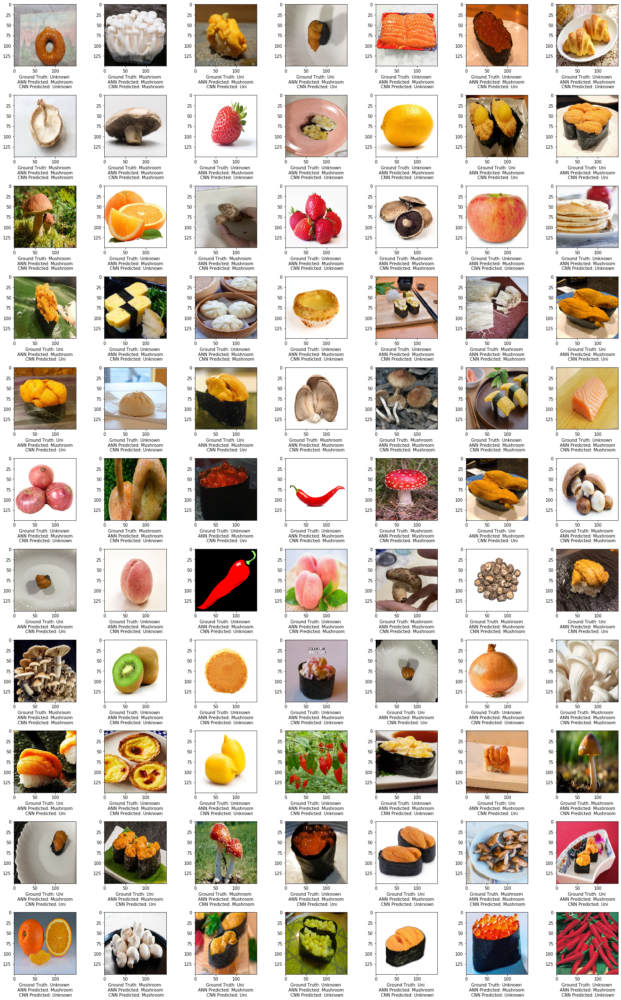

In [43]:
def visualize_prediction():
    n = 77
    num_row, num_col = 11, 7
    fig, axes = plt.subplots(num_row, num_col, figsize=(3* num_col, 3* num_row))
    
    #Select Model for prediction
    ann_predicted = ann.predict(test_batch)
    cnn_predicted = cnn.predict(test_batch)
    
    for i in range(n):
        img = np.array(test_batch[0][i] * 255, dtype='uint8')
        ax = axes[i // num_col, i% num_col]
        
        #ANN Model
        predicted_class_index_ANN = np.argmax(ann_predicted[i])
        predicted_class_ANN = classes[predicted_class_index_ANN]

        #CNN Model
        predicted_class_index_CNN = np.argmax(cnn_predicted[i])
        predicted_class_CNN = classes[predicted_class_index_CNN]
        
        class_index = np.argmax(test_batch[1][i]) 
        class_index_truth = classes[class_index]
        
        ax.set_xlabel(f'Ground Truth: {class_index_truth} \n ANN Predicted: {predicted_class_ANN} \n CNN Predicted: {predicted_class_CNN}')
        ax.imshow(img)
        
    plt.tight_layout()
    plt.show()
visualize_prediction()

From the metricts produced, it is clear that the CNN out peforms the ANN siginifcantly. Acheiving an approxiamte accuracy of 85% and 25% respectively, which is 3.4 times difference in accuracy. Not only is the accuracy better, the CNN also has a lower loss value of 0.4 while the ANN has a loss value of approximately 1. This highlights that the CNN is better able to learn patterns as it able to minimize loss better.

In conclusion, while the ANN is able to peform image classification, it is not as optimal as the CNN. While CNNs are better suited for this task, our current CNN still has much room for improvement.

# Step 3.4 Optimizing our CNN model (Hyperparamter Tuning)

Optimzing is a long process, it often requires a lot of trial and error. To tackle this issue we decided to build a whole bunch of models with varying combinations of hyperparamters. Incoprating TensorBoard, a visualization tool, we are able to build many models and easily compare their metricts.

In [11]:
#Customization of CNN

#Hyperparamters: 

#Layer SizeL 32,64/128
layer_sizes = [32, 64, 128]

#Conv Layer: 1/2/3
conv_layers = [1, 2, 3]

#Dropout:
dropout_range = [0.2, 0.5]

#Dense Layer: 1/2
dense_layers = [0, 1 ,2]

#Optimizer: adam, sgd, rmsprop
optimizers = ['adam', 'sgd', 'rmsprop']

#Parameters:
epochs = 5


for dense_layer in dense_layers:
    for layer_size in layer_sizes:
        for conv_layer in conv_layers:
            for dropout in dropout_range:
                for optimizer in optimizers:
                    NAME = "{}-conv-{}-nodes-{}-dense-{}-dropot-{}-opt-{}".format(conv_layer, layer_size,dense_layer, dropout, optimizer, int(time.time()))
                    logdir = os.path.join("logs", "fit_hyperparam_last", NAME)
                    tensorboard = TensorBoard(logdir)                                            
                    print(f'Building Model: {NAME}')

                    #Create a Sequetial Model
                    model = models.Sequential()

                    #Add 1st Conv Layer                                           
                    model.add(layers.Conv2D(layer_size, (3,3), input_shape=(IMG_HEIGHT, IMG_WIDTH,3)))
                    model.add(layers.Activation('relu'))
                    model.add(layers.MaxPooling2D(pool_size=(2,2)))

                    #Add Conv Layers                                              
                    for i in range(conv_layer - 1):
                        model.add(layers.Conv2D(layer_size, (3,3), input_shape=(IMG_HEIGHT, IMG_WIDTH,3)))
                        model.add(layers.Activation('relu'))
                        model.add(layers.MaxPooling2D(pool_size=(2,2)))

                    #Add Dropout and then Flatten
                    model.add(layers.Dropout(dropout))
                    model.add(layers.Flatten())

                    #Add Desne Layers                                             
                    for i in range(dense_layer):
                        model.add(layers.Dense(layer_size))
                        model.add(layers.Activation('relu'))

                    #Set up Softmax Layer for number of classes                            
                    model.add(layers.Dense(len(classes)))
                    model.add(layers.Activation('softmax'))

                    #Compile our model          
                    model.compile(optimizer=optimizer,
                                  loss='categorical_crossentropy',
                                  metrics=['accuracy'])

                    #Start Training the model
                    model.fit(train_data, validation_data=valid_data, epochs=epochs, callbacks=[tensorboard])
                    tf.keras.backend.clear_session()

Building Model: 1-conv-64-nodes-0-dense-0.2-dropot-adam-opt-1641032339
  ...
    to  
  ['...']


C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
18/22 [=======================>......] - ETA: 14s - loss: 8.3794 - accuracy: 0.4246

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 95s 4s/step - loss: 7.2035 - accuracy: 0.3927 - val_loss: 1.1083 - val_accuracy: 0.5708
Epoch 2/5
22/22 [==============================] - 95s 4s/step - loss: 0.8602 - accuracy: 0.6372 - val_loss: 0.8031 - val_accuracy: 0.6208
Epoch 3/5
22/22 [==============================] - 93s 4s/step - loss: 0.6935 - accuracy: 0.7190 - val_loss: 0.7594 - val_accuracy: 0.6875
Epoch 4/5
22/22 [==============================] - 98s 4s/step - loss: 0.6012 - accuracy: 0.7759 - val_loss: 0.6223 - val_accuracy: 0.8208
Epoch 5/5
22/22 [==============================] - 73s 3s/step - loss: 0.5450 - accuracy: 0.8073 - val_loss: 0.6270 - val_accuracy: 0.8125
Building Model: 1-conv-64-nodes-0-dense-0.5-dropot-adam-opt-1641032808
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
14/22 [==================>...........] - ETA: 22s - loss: 6.4314 - accuracy: 0.4242

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 73s 3s/step - loss: 4.5770 - accuracy: 0.4182 - val_loss: 1.2235 - val_accuracy: 0.3625
Epoch 2/5
22/22 [==============================] - 77s 3s/step - loss: 0.8953 - accuracy: 0.6109 - val_loss: 0.8086 - val_accuracy: 0.6792
Epoch 3/5
22/22 [==============================] - 74s 3s/step - loss: 0.7086 - accuracy: 0.7088 - val_loss: 0.6865 - val_accuracy: 0.7875
Epoch 4/5
22/22 [==============================] - 79s 4s/step - loss: 0.6253 - accuracy: 0.7584 - val_loss: 0.6055 - val_accuracy: 0.8083
Epoch 5/5
22/22 [==============================] - 79s 4s/step - loss: 0.5634 - accuracy: 0.7978 - val_loss: 0.5861 - val_accuracy: 0.8167
Building Model: 2-conv-64-nodes-0-dense-0.2-dropot-adam-opt-1641033195
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
12/22 [===============>..............] - ETA: 32s - loss: 1.5080 - accuracy: 0.4427

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 80s 4s/step - loss: 1.2054 - accuracy: 0.5394 - val_loss: 0.8458 - val_accuracy: 0.6375
Epoch 2/5
22/22 [==============================] - 83s 4s/step - loss: 0.7191 - accuracy: 0.7175 - val_loss: 0.6942 - val_accuracy: 0.7292
Epoch 3/5
22/22 [==============================] - 80s 4s/step - loss: 0.6589 - accuracy: 0.7270 - val_loss: 0.6932 - val_accuracy: 0.7208
Epoch 4/5
22/22 [==============================] - 77s 4s/step - loss: 0.5931 - accuracy: 0.7723 - val_loss: 0.5691 - val_accuracy: 0.8667
Epoch 5/5
22/22 [==============================] - 77s 4s/step - loss: 0.5259 - accuracy: 0.8088 - val_loss: 0.5105 - val_accuracy: 0.8417
Building Model: 2-conv-64-nodes-0-dense-0.5-dropot-adam-opt-1641033597
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
21/22 [===========================>..] - ETA: 2s - loss: 1.1659 - accuracy: 0.4640

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 75s 3s/step - loss: 1.1550 - accuracy: 0.4672 - val_loss: 0.9521 - val_accuracy: 0.5000
Epoch 2/5
22/22 [==============================] - 74s 3s/step - loss: 0.8634 - accuracy: 0.6219 - val_loss: 0.8503 - val_accuracy: 0.6792
Epoch 3/5
22/22 [==============================] - 77s 4s/step - loss: 0.7752 - accuracy: 0.6949 - val_loss: 0.7901 - val_accuracy: 0.7042
Epoch 4/5
22/22 [==============================] - 73s 3s/step - loss: 0.7006 - accuracy: 0.7212 - val_loss: 0.6437 - val_accuracy: 0.7625
Epoch 5/5
22/22 [==============================] - 71s 3s/step - loss: 0.6152 - accuracy: 0.7642 - val_loss: 0.6687 - val_accuracy: 0.7375
Building Model: 3-conv-64-nodes-0-dense-0.2-dropot-adam-opt-1641033975
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
 5/22 [=====>........................] - ETA: 46s - loss: 1.1121 - accuracy: 0.3333

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 77s 4s/step - loss: 0.9637 - accuracy: 0.5336 - val_loss: 0.8036 - val_accuracy: 0.6583
Epoch 2/5
22/22 [==============================] - 71s 3s/step - loss: 0.6758 - accuracy: 0.7234 - val_loss: 0.6213 - val_accuracy: 0.7708
Epoch 3/5
22/22 [==============================] - 69s 3s/step - loss: 0.6737 - accuracy: 0.7489 - val_loss: 0.6833 - val_accuracy: 0.7625
Epoch 4/5
22/22 [==============================] - 69s 3s/step - loss: 0.6202 - accuracy: 0.7818 - val_loss: 0.5750 - val_accuracy: 0.7792
Epoch 5/5
22/22 [==============================] - 69s 3s/step - loss: 0.5329 - accuracy: 0.8073 - val_loss: 0.5408 - val_accuracy: 0.7833
Building Model: 3-conv-64-nodes-0-dense-0.5-dropot-adam-opt-1641034336
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
 2/22 [=>............................] - ETA: 1:07 - loss: 1.1343 - accuracy: 0.4297

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 72s 3s/step - loss: 0.9862 - accuracy: 0.5438 - val_loss: 0.8589 - val_accuracy: 0.6042
Epoch 2/5
22/22 [==============================] - 71s 3s/step - loss: 0.7506 - accuracy: 0.7102 - val_loss: 0.7174 - val_accuracy: 0.7250
Epoch 3/5
22/22 [==============================] - 73s 3s/step - loss: 0.7050 - accuracy: 0.7197 - val_loss: 0.7093 - val_accuracy: 0.7417
Epoch 4/5
22/22 [==============================] - 71s 3s/step - loss: 0.6519 - accuracy: 0.7438 - val_loss: 0.5983 - val_accuracy: 0.8125
Epoch 5/5
22/22 [==============================] - 71s 3s/step - loss: 0.5931 - accuracy: 0.7825 - val_loss: 0.5430 - val_accuracy: 0.8000
Building Model: 1-conv-128-nodes-0-dense-0.2-dropot-adam-opt-1641034700
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
19/22 [========================>.....] - ETA: 8s - loss: 3.4042 - accuracy: 0.5093 

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 74s 3s/step - loss: 3.0416 - accuracy: 0.5372 - val_loss: 0.9194 - val_accuracy: 0.6125
Epoch 2/5
22/22 [==============================] - 80s 4s/step - loss: 0.6453 - accuracy: 0.7409 - val_loss: 0.6512 - val_accuracy: 0.7833
Epoch 3/5
22/22 [==============================] - 72s 3s/step - loss: 0.5423 - accuracy: 0.8146 - val_loss: 0.5503 - val_accuracy: 0.8250
Epoch 4/5
22/22 [==============================] - 74s 3s/step - loss: 0.5337 - accuracy: 0.8234 - val_loss: 0.5376 - val_accuracy: 0.8333
Epoch 5/5
22/22 [==============================] - 77s 4s/step - loss: 0.5049 - accuracy: 0.8190 - val_loss: 0.5524 - val_accuracy: 0.8333
Building Model: 1-conv-128-nodes-0-dense-0.5-dropot-adam-opt-1641035081
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
11/22 [==============>...............] - ETA: 33s - loss: 9.5102 - accuracy: 0.4489 

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 78s 4s/step - loss: 5.6910 - accuracy: 0.4584 - val_loss: 0.9784 - val_accuracy: 0.6042
Epoch 2/5
22/22 [==============================] - 88s 4s/step - loss: 0.8032 - accuracy: 0.6701 - val_loss: 0.7503 - val_accuracy: 0.7375
Epoch 3/5
22/22 [==============================] - 83s 4s/step - loss: 0.6663 - accuracy: 0.7343 - val_loss: 0.6499 - val_accuracy: 0.7792
Epoch 4/5
22/22 [==============================] - 75s 3s/step - loss: 0.6044 - accuracy: 0.7752 - val_loss: 0.6274 - val_accuracy: 0.8167
Epoch 5/5
22/22 [==============================] - 74s 3s/step - loss: 0.5342 - accuracy: 0.8044 - val_loss: 0.6106 - val_accuracy: 0.8250
Building Model: 2-conv-128-nodes-0-dense-0.2-dropot-adam-opt-1641035485
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
14/22 [==================>...........] - ETA: 22s - loss: 1.4336 - accuracy: 0.4476

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 75s 3s/step - loss: 1.2168 - accuracy: 0.5182 - val_loss: 0.8095 - val_accuracy: 0.6792
Epoch 2/5
22/22 [==============================] - 74s 3s/step - loss: 0.7293 - accuracy: 0.7146 - val_loss: 0.7678 - val_accuracy: 0.6833
Epoch 3/5
22/22 [==============================] - 76s 3s/step - loss: 0.7090 - accuracy: 0.7168 - val_loss: 0.6648 - val_accuracy: 0.7833
Epoch 4/5
22/22 [==============================] - 74s 3s/step - loss: 0.6165 - accuracy: 0.7555 - val_loss: 0.6109 - val_accuracy: 0.7708
Epoch 5/5
22/22 [==============================] - 71s 3s/step - loss: 0.5800 - accuracy: 0.7891 - val_loss: 0.5628 - val_accuracy: 0.8042
Building Model: 2-conv-128-nodes-0-dense-0.5-dropot-adam-opt-1641035862
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
 1/22 [>.............................] - ETA: 1:09 - loss: 1.0953 - accuracy: 0.4688

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 75s 3s/step - loss: 1.0967 - accuracy: 0.5745 - val_loss: 0.8463 - val_accuracy: 0.6167
Epoch 2/5
22/22 [==============================] - 72s 3s/step - loss: 0.7078 - accuracy: 0.7139 - val_loss: 0.7321 - val_accuracy: 0.6792
Epoch 3/5
22/22 [==============================] - 75s 3s/step - loss: 0.6100 - accuracy: 0.7555 - val_loss: 0.6272 - val_accuracy: 0.7667
Epoch 4/5
22/22 [==============================] - 73s 3s/step - loss: 0.6439 - accuracy: 0.7657 - val_loss: 0.6098 - val_accuracy: 0.7958
Epoch 5/5
22/22 [==============================] - 74s 3s/step - loss: 0.5643 - accuracy: 0.7949 - val_loss: 0.5358 - val_accuracy: 0.8250
Building Model: 3-conv-128-nodes-0-dense-0.2-dropot-adam-opt-1641036237
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
 6/22 [=======>......................] - ETA: 49s - loss: 1.1295 - accuracy: 0.4714

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 76s 3s/step - loss: 0.9933 - accuracy: 0.5540 - val_loss: 0.7813 - val_accuracy: 0.7083
Epoch 2/5
22/22 [==============================] - 74s 3s/step - loss: 0.7233 - accuracy: 0.7102 - val_loss: 0.6744 - val_accuracy: 0.7500
Epoch 3/5
22/22 [==============================] - 72s 3s/step - loss: 0.6708 - accuracy: 0.7285 - val_loss: 0.6648 - val_accuracy: 0.7292
Epoch 4/5
22/22 [==============================] - 75s 3s/step - loss: 0.6455 - accuracy: 0.7328 - val_loss: 0.5808 - val_accuracy: 0.7917
Epoch 5/5
22/22 [==============================] - 82s 4s/step - loss: 0.5611 - accuracy: 0.7832 - val_loss: 0.5703 - val_accuracy: 0.7833
Building Model: 3-conv-128-nodes-0-dense-0.5-dropot-adam-opt-1641036622
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
14/22 [==================>...........] - ETA: 27s - loss: 0.9950 - accuracy: 0.5502

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 85s 4s/step - loss: 0.9093 - accuracy: 0.6044 - val_loss: 0.7877 - val_accuracy: 0.7042
Epoch 2/5
22/22 [==============================] - 80s 4s/step - loss: 0.7469 - accuracy: 0.7263 - val_loss: 0.7578 - val_accuracy: 0.6917
Epoch 3/5
22/22 [==============================] - 76s 3s/step - loss: 0.6745 - accuracy: 0.7547 - val_loss: 0.6503 - val_accuracy: 0.7708
Epoch 4/5
22/22 [==============================] - 74s 3s/step - loss: 0.6140 - accuracy: 0.7672 - val_loss: 0.6315 - val_accuracy: 0.7917
Epoch 5/5
22/22 [==============================] - 75s 3s/step - loss: 0.5558 - accuracy: 0.8029 - val_loss: 0.5845 - val_accuracy: 0.7875
Building Model: 1-conv-64-nodes-1-dense-0.2-dropot-adam-opt-1641037018
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
10/22 [============>.................] - ETA: 35s - loss: 13.9344 - accuracy: 0.4236

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 76s 3s/step - loss: 7.5049 - accuracy: 0.4051 - val_loss: 0.9435 - val_accuracy: 0.5625
Epoch 2/5
22/22 [==============================] - 73s 3s/step - loss: 0.8921 - accuracy: 0.6255 - val_loss: 0.8032 - val_accuracy: 0.6583
Epoch 3/5
22/22 [==============================] - 80s 4s/step - loss: 0.7027 - accuracy: 0.7190 - val_loss: 0.6461 - val_accuracy: 0.7792
Epoch 4/5
22/22 [==============================] - 72s 3s/step - loss: 0.6217 - accuracy: 0.7599 - val_loss: 0.5812 - val_accuracy: 0.7875
Epoch 5/5
22/22 [==============================] - 73s 3s/step - loss: 0.5396 - accuracy: 0.7832 - val_loss: 0.5280 - val_accuracy: 0.8167
Building Model: 1-conv-64-nodes-1-dense-0.5-dropot-adam-opt-1641037396
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
 3/22 [===>..........................] - ETA: 58s - loss: 20.3445 - accuracy: 0.3542

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 74s 3s/step - loss: 8.0051 - accuracy: 0.4088 - val_loss: 1.1075 - val_accuracy: 0.2583
Epoch 2/5
22/22 [==============================] - 74s 3s/step - loss: 0.9317 - accuracy: 0.5321 - val_loss: 0.8081 - val_accuracy: 0.6500
Epoch 3/5
22/22 [==============================] - 73s 3s/step - loss: 0.7063 - accuracy: 0.7285 - val_loss: 0.7038 - val_accuracy: 0.7542
Epoch 4/5
22/22 [==============================] - 73s 3s/step - loss: 0.5943 - accuracy: 0.7818 - val_loss: 0.5752 - val_accuracy: 0.8167
Epoch 5/5
22/22 [==============================] - 73s 3s/step - loss: 0.5186 - accuracy: 0.8051 - val_loss: 0.5657 - val_accuracy: 0.8208
Building Model: 2-conv-64-nodes-1-dense-0.2-dropot-adam-opt-1641037768
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
 6/22 [=======>......................] - ETA: 39s - loss: 2.8311 - accuracy: 0.3584

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 72s 3s/step - loss: 1.4580 - accuracy: 0.5365 - val_loss: 0.8372 - val_accuracy: 0.6833
Epoch 2/5
22/22 [==============================] - 73s 3s/step - loss: 0.7132 - accuracy: 0.7124 - val_loss: 0.6459 - val_accuracy: 0.7375
Epoch 3/5
22/22 [==============================] - 72s 3s/step - loss: 0.6246 - accuracy: 0.7540 - val_loss: 0.5819 - val_accuracy: 0.7667
Epoch 4/5
22/22 [==============================] - 73s 3s/step - loss: 0.5556 - accuracy: 0.7905 - val_loss: 0.5413 - val_accuracy: 0.8042
Epoch 5/5
22/22 [==============================] - 78s 4s/step - loss: 0.5110 - accuracy: 0.8073 - val_loss: 0.4621 - val_accuracy: 0.8417
Building Model: 2-conv-64-nodes-1-dense-0.5-dropot-adam-opt-1641038140
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
14/22 [==================>...........] - ETA: 24s - loss: 1.2960 - accuracy: 0.3974

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 76s 3s/step - loss: 1.1578 - accuracy: 0.4861 - val_loss: 0.8545 - val_accuracy: 0.6250
Epoch 2/5
22/22 [==============================] - 73s 3s/step - loss: 0.7381 - accuracy: 0.7015 - val_loss: 0.7781 - val_accuracy: 0.7167
Epoch 3/5
22/22 [==============================] - 73s 3s/step - loss: 0.6682 - accuracy: 0.7438 - val_loss: 0.6640 - val_accuracy: 0.7542
Epoch 4/5
22/22 [==============================] - 73s 3s/step - loss: 0.5885 - accuracy: 0.7818 - val_loss: 0.5764 - val_accuracy: 0.8000
Epoch 5/5
22/22 [==============================] - 68s 3s/step - loss: 0.5651 - accuracy: 0.7912 - val_loss: 0.5135 - val_accuracy: 0.8292
Building Model: 3-conv-64-nodes-1-dense-0.2-dropot-adam-opt-1641038509
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
 6/22 [=======>......................] - ETA: 37s - loss: 1.4706 - accuracy: 0.3902

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 69s 3s/step - loss: 1.1679 - accuracy: 0.4117 - val_loss: 0.9408 - val_accuracy: 0.6208
Epoch 2/5
22/22 [==============================] - 68s 3s/step - loss: 0.8211 - accuracy: 0.6839 - val_loss: 0.7836 - val_accuracy: 0.6958
Epoch 3/5
22/22 [==============================] - 69s 3s/step - loss: 0.7340 - accuracy: 0.7139 - val_loss: 0.7076 - val_accuracy: 0.7083
Epoch 4/5
22/22 [==============================] - 73s 3s/step - loss: 0.6529 - accuracy: 0.7555 - val_loss: 0.7103 - val_accuracy: 0.7083
Epoch 5/5
22/22 [==============================] - 72s 3s/step - loss: 0.6214 - accuracy: 0.7664 - val_loss: 0.5859 - val_accuracy: 0.7833
Building Model: 3-conv-64-nodes-1-dense-0.5-dropot-adam-opt-1641038866
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
 8/22 [=========>....................] - ETA: 43s - loss: 1.0762 - accuracy: 0.5234

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 78s 4s/step - loss: 0.9272 - accuracy: 0.6029 - val_loss: 0.7667 - val_accuracy: 0.7167
Epoch 2/5
22/22 [==============================] - 74s 3s/step - loss: 0.6971 - accuracy: 0.7285 - val_loss: 0.8461 - val_accuracy: 0.7000
Epoch 3/5
22/22 [==============================] - 71s 3s/step - loss: 0.6278 - accuracy: 0.7642 - val_loss: 0.5734 - val_accuracy: 0.8042
Epoch 4/5
22/22 [==============================] - 71s 3s/step - loss: 0.5577 - accuracy: 0.7942 - val_loss: 0.5042 - val_accuracy: 0.8167
Epoch 5/5
22/22 [==============================] - 80s 4s/step - loss: 0.4994 - accuracy: 0.8153 - val_loss: 0.4918 - val_accuracy: 0.8000
Building Model: 1-conv-128-nodes-1-dense-0.2-dropot-adam-opt-1641039247
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
16/22 [====================>.........] - ETA: 17s - loss: 16.3605 - accuracy: 0.4238

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 71s 3s/step - loss: 12.3224 - accuracy: 0.4766 - val_loss: 0.8685 - val_accuracy: 0.6625
Epoch 2/5
22/22 [==============================] - 89s 4s/step - loss: 0.7683 - accuracy: 0.6796 - val_loss: 0.7912 - val_accuracy: 0.6583
Epoch 3/5
22/22 [==============================] - 85s 4s/step - loss: 0.6506 - accuracy: 0.7591 - val_loss: 0.6530 - val_accuracy: 0.8042
Epoch 4/5
22/22 [==============================] - 85s 4s/step - loss: 0.5725 - accuracy: 0.7861 - val_loss: 0.6010 - val_accuracy: 0.8083
Epoch 5/5
22/22 [==============================] - 83s 4s/step - loss: 0.4989 - accuracy: 0.8204 - val_loss: 0.4697 - val_accuracy: 0.8625
Building Model: 1-conv-128-nodes-1-dense-0.5-dropot-adam-opt-1641039665
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
16/22 [====================>.........] - ETA: 18s - loss: 20.9196 - accuracy: 0.3540

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 75s 3s/step - loss: 15.5387 - accuracy: 0.3818 - val_loss: 1.0082 - val_accuracy: 0.5875
Epoch 2/5
22/22 [==============================] - 77s 3s/step - loss: 0.8812 - accuracy: 0.6628 - val_loss: 0.8276 - val_accuracy: 0.6625
Epoch 3/5
22/22 [==============================] - 73s 3s/step - loss: 0.7237 - accuracy: 0.7080 - val_loss: 0.6634 - val_accuracy: 0.7167
Epoch 4/5
22/22 [==============================] - 74s 3s/step - loss: 0.6387 - accuracy: 0.7577 - val_loss: 0.6280 - val_accuracy: 0.7833
Epoch 5/5
22/22 [==============================] - 90s 4s/step - loss: 0.5842 - accuracy: 0.7745 - val_loss: 0.5830 - val_accuracy: 0.8125
Building Model: 2-conv-128-nodes-1-dense-0.2-dropot-adam-opt-1641040059
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
13/22 [================>.............] - ETA: 34s - loss: 2.7562 - accuracy: 0.4093

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 96s 4s/step - loss: 2.0477 - accuracy: 0.4737 - val_loss: 0.8770 - val_accuracy: 0.5917
Epoch 2/5
22/22 [==============================] - 97s 4s/step - loss: 0.7268 - accuracy: 0.7153 - val_loss: 0.7810 - val_accuracy: 0.7667
Epoch 3/5
22/22 [==============================] - 96s 4s/step - loss: 0.6440 - accuracy: 0.7533 - val_loss: 0.5658 - val_accuracy: 0.8000
Epoch 4/5
22/22 [==============================] - 71s 3s/step - loss: 0.5260 - accuracy: 0.7993 - val_loss: 0.5801 - val_accuracy: 0.7958
Epoch 5/5
22/22 [==============================] - 72s 3s/step - loss: 0.4676 - accuracy: 0.8226 - val_loss: 0.4330 - val_accuracy: 0.8333
Building Model: 2-conv-128-nodes-1-dense-0.5-dropot-adam-opt-1641040500
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/5
11/22 [==============>...............] - ETA: 34s - loss: 3.5325 - accuracy: 0.3920

KeyboardInterrupt: 

In [175]:
#Ensure to set the correct log directory path
%tensorboard --logdir prev_logs/fit_hyperparam2 --host localhost

Reusing TensorBoard on port 6006 (pid 16256), started 0:00:58 ago. (Use '!kill 16256' to kill it.)

C:\Users\Gamepro\anaconda3\lib\site-packages\tensorboard\notebook.py:383: DeprecationWarning: cgi.escape is deprecated, use html.escape instead
  ("%HTML_ID%", cgi.escape(frame_id, quote=True)),


After training all the models and comparing the differences, we discovered that the hyperparamters that worked best for our model was 2conv-64nodes-1dense-0.2dropout-adam-opt. As it had to overall highest accuracy and lowest loss. Now lets build our new model according to the optimal hyperparamters.

In [12]:
# Train: 3conv-64nodes-2dense-0.2Dropout-Adam

#Reduce Learning Rate when it stagnates
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                              patience=5, min_lr=0.001, mode='auto')

#Create a Sequetial Model
cnn_optimal = models.Sequential()

#Add 1st Conv Layer                                           
cnn_optimal.add(layers.Conv2D(64, (3,3), input_shape=(IMG_HEIGHT, IMG_WIDTH,3)))
cnn_optimal.add(layers.Activation('relu'))
cnn_optimal.add(layers.MaxPooling2D(pool_size=(2,2)))

#Add 2nd Conv Layer                                           
cnn_optimal.add(layers.Conv2D(64, (3,3), input_shape=(IMG_HEIGHT, IMG_WIDTH,3)))
cnn_optimal.add(layers.Activation('relu'))
cnn_optimal.add(layers.MaxPooling2D(pool_size=(2,2)))

#Add 3rd Conv Layer                                           
cnn_optimal.add(layers.Conv2D(64, (3,3), input_shape=(IMG_HEIGHT, IMG_WIDTH,3)))
cnn_optimal.add(layers.Activation('relu'))
cnn_optimal.add(layers.MaxPooling2D(pool_size=(2,2)))

#Add Dropout and Flatten Layer
cnn_optimal.add(layers.Dropout(0.2))
cnn_optimal.add(layers.Flatten())

#Add 1st Dense Layer
cnn_optimal.add(layers.Dense(64))
cnn_optimal.add(layers.Activation('relu'))

#Add 2nd Dense Layer
cnn_optimal.add(layers.Dense(64))
cnn_optimal.add(layers.Activation('relu'))

#Set up Softmax Layer for number of classes                            
cnn_optimal.add(layers.Dense(len(classes)))
cnn_optimal.add(layers.Activation('softmax'))

#Compile our model          
cnn_optimal.compile(optimizer="adam",
            loss='categorical_crossentropy',
            metrics=['accuracy'])

#Start Training the model
cnn_optimal.fit(train_data_da, validation_data=valid_data, epochs=20, callbacks=[reduce_lr])

  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 22 steps, validate for 4 steps
Epoch 1/20
13/22 [================>.............] - ETA: 35s - loss: 1.1262 - accuracy: 0.4243

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


22/22 [==============================] - 96s 4s/step - loss: 1.0634 - accuracy: 0.4810 - val_loss: 0.9081 - val_accuracy: 0.5708
Epoch 2/20
22/22 [==============================] - 95s 4s/step - loss: 0.7629 - accuracy: 0.6978 - val_loss: 0.7299 - val_accuracy: 0.7042
Epoch 3/20
22/22 [==============================] - 84s 4s/step - loss: 0.6782 - accuracy: 0.7255 - val_loss: 0.6861 - val_accuracy: 0.7333
Epoch 4/20
22/22 [==============================] - 75s 3s/step - loss: 0.6253 - accuracy: 0.7540 - val_loss: 0.5063 - val_accuracy: 0.8000
Epoch 5/20
22/22 [==============================] - 83s 4s/step - loss: 0.5193 - accuracy: 0.8007 - val_loss: 0.4717 - val_accuracy: 0.8083
Epoch 6/20
22/22 [==============================] - 87s 4s/step - loss: 0.4887 - accuracy: 0.8131 - val_loss: 0.4256 - val_accuracy: 0.8500
Epoch 7/20
22/22 [==============================] - 79s 4s/step - loss: 0.4262 - accuracy: 0.8292 - val_loss: 0.4148 - val_accuracy: 0.8417
Epoch 8/20
22/22 [=============

# Step 3.5 Optimized CNN Results

After training the optimal CNN model for 20 epochs, it was able to achieve a solid 89% accuracy and a loss value of 0.2385 on our test dataset. 

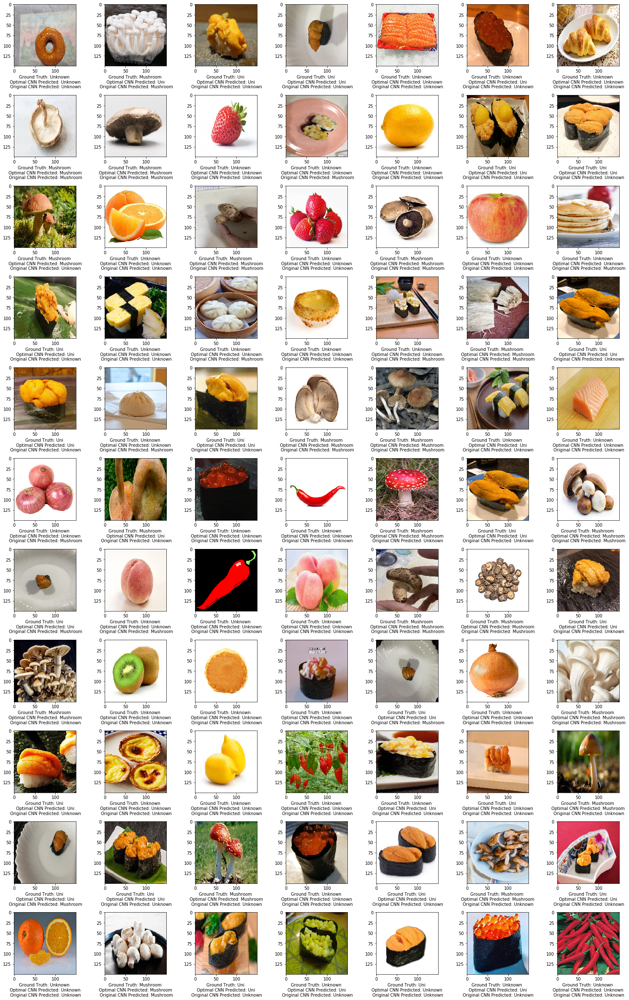

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_2 (Conv2D)            (None, 148, 148, 128)     3584      
_________________________________________________________________
activation_4 (Activation)    (None, 148, 148, 128)     0         
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 74, 74, 128)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 72, 72, 128)       147584    
_________________________________________________________________
activation_5 (Activation)    (None, 72, 72, 128)       0         
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 36, 36, 128)       0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 34, 34, 128)      

NameError: name 'y_test_label' is not defined

In [24]:
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import Input, Average, Maximum
def visualize_prediction():
    n = 77
    num_row, num_col = 11, 7
    fig, axes = plt.subplots(num_row, num_col, figsize=(3* num_col, 3* num_row))
    
    #Select Model for prediction
    cnn_optimal = load_model("final_cnn_opt.hdf5")
    cnn = load_model("cock.hdf5")
    cnn_opt_predicted = cnn_optimal.predict(test_batch)
    cnn_predicted = cnn.predict(test_batch)
    
    for i in range(n):
        img = np.array(test_batch[0][i] * 255, dtype='uint8')
        ax = axes[i // num_col, i% num_col]
        
        #Ground Truth
        class_index = np.argmax(test_batch[1][i]) 
        class_index_truth = classes[class_index]
        
        #CNN Optimal Model
        predicted_class_index_CNN_OPT = np.argmax(cnn_opt_predicted[i])
        predicted_class_CNN_OPT = classes[predicted_class_index_CNN_OPT]
        
        #CNN Original Model
        predicted_class_index_CNN = np.argmax(cnn_predicted[i])
        predicted_class_CNN = classes[predicted_class_index_CNN]

        
        ax.set_xlabel(f'Ground Truth: {class_index_truth} \n Optimal CNN Predicted: {predicted_class_CNN_OPT} \n Original CNN Predicted: {predicted_class_CNN}')
        ax.imshow(img)
        
    plt.tight_layout()
    plt.show()
visualize_prediction()

cnn_optimal.summary()
y_cnn_optimal = cnn.predict(test_batch)
y_cnn_optima_predicted = [np.argmax(element) for element in y_cnn_optimal]
print("\n **************** Classification Report Optimal CNN ****************\n\n", classification_report(y_test_label, y_cnn_optima_predicted))
print("\n" ,cnn_optimal.evaluate(X_test, y_test), "\n")
print("*******************************************************************\n")

From the metricts generated, we manged to construct a more accurate and efficent model. However while it peforms better on our test dataset, it could definitely still peform better. We think that the main reason for our peformace is due to the imbalnced dataset. We have nearly double the amount of mushroom images as compared to the other two categories, this leads to a bias predictions favouring mushrooms.

# Step 4. Ensemble Learning Technique

Ensemble Learning is a method used in machine learning to help increase predictive peformance of models. The idea behind it is to use multiple models with different weights to peform the same set of predictions. Combining their predictions together and obtaining a final set of results to use. At the same time we want to use this method to tackle our imbalnced dataset. We can acomplish this by spliting the mushroom dataset into half, training each half with the other two classes. This will allow us to generate 2 new models that will have a balanced ratio. At the same time these two will act as new predictions we can use to determine our final value.

First lets prepare the new dataset, we need to seperate the mushroom images from the other two classes. Then split them evenly into two sets and then prepare two datasets that we can use for training.

# Step 4.1 Preparing the new Dataset

In [9]:
#Load Training Data and Store into a DataFrame
temp = []
train_dir = "D:/muu/train"
for img_class in os.listdir(train_dir):
    sub_fldr = os.path.join(train_dir, img_class)
    for img in os.listdir(sub_fldr):
        img_path = os.path.join(sub_fldr, img)
        temp.append((img_path, img_class))
        
df_train = pd.DataFrame(temp, columns=['filename','class'])

#Seperate the Mushroom Class from DataFrame
df_mushroom = df_train[ df_train['class'] == "mushroom"]
df_seperated = df_train.drop(df_mushroom.index, axis=0)

#Split the Mushroom Class evenly into two sets
total_mushroom = len(df_mushroom.index)
batch_mushroom = 2
split_amt = total_mushroom / batch_mushroom

#Append and generate the new datastes
train_batch1 = df_mushroom.loc[split_amt*0 : split_amt*(1)].append(df_seperated)
train_batch2 = df_mushroom.loc[split_amt*1 : split_amt*(2)].append(df_seperated)

train1 = train_batch1.head().style.set_table_attributes("style='display:inline'")
train2 = train_batch2.head().style.set_table_attributes("style='display:inline'")
display_html(train1._repr_html_() + train2._repr_html_(), raw = True)

,filename,class
0,D:/muu/train\mushroom\mushroom_train_0.jpg,mushroom
1,D:/muu/train\mushroom\mushroom_train_1.jpg,mushroom
2,D:/muu/train\mushroom\mushroom_train_10.jpg,mushroom
3,D:/muu/train\mushroom\mushroom_train_100.jpg,mushroom
4,D:/muu/train\mushroom\mushroom_train_101.jpg,mushroom
,filename,class
403,D:/muu/train\mushroom\mushroom_train_461.jpg,mushroom
404,D:/muu/train\mushroom\mushroom_train_462.jpg,mushroom
405,D:/muu/train\mushroom\mushroom_train_463.jpg,mushroom
406,D:/muu/train\mushroom\mushroom_train_464.jpg,mushroom


Now that we have created the new datasets, we have to load them and process them like we did previously. This time we used the Pandas DataFrame to store our dataset. This allows us to easily splice and manipulate the data so that we could acheive our desired modifications. Next lets load our dataframe with ImageDataGenerator.

In [10]:
#Load the new dataset and peform basic normalization and data augemntation
data_gen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255,
    rotation_range = 30,
    zoom_range = 0.2,
    width_shift_range=0.1,
    height_shift_range=0.1
)

print("Ensemble 1 Training Data")
ensemble_batch_1 = data_gen.flow_from_dataframe(
    validate_filenames=False,
    dataframe = train_batch1,
    x_col= "filename",
    y_col= "class",
    subset="training",
    batch_size=64,
    seed=42,
    shuffle=True,
    class_mode="categorical",
    target_size=(IMG_HEIGHT, IMG_WIDTH)
)

print("\nEnsemble 2 Training Data")
ensemble_batch_2 = data_gen.flow_from_dataframe(
    validate_filenames=False,
    dataframe = train_batch2,
    x_col= "filename",
    y_col= "class",
    subset="training",
    batch_size=64,
    seed=42,
    shuffle=True,
    class_mode="categorical",
    target_size=(IMG_HEIGHT, IMG_WIDTH)
)

Ensemble 1 Training Data
Found 1208 non-validated image filenames belonging to 3 classes.

Ensemble 2 Training Data
Found 1207 non-validated image filenames belonging to 3 classes.


# Step 4.2 Finding Optimal Hyperparamters for new models

As the structure of the model has been modified, the same set of hyperparamters may not be as optimal. So lets once again use the same method as previously to find out the optimal paramters for our new dataset.

In [16]:
#Find optimal model
#Customization of CNN-Ensemble

#Hyperparamters: 
#3Conv-64Nodes-0Desne-0.2Dropout-AdamOpt

#Dense Layer: 1/2
dense_layers = [1 ,2,3 ]

#Layer SizeL 32,64/128
layer_sizes = [32, 64, 128]

#Conv Layer: 1
conv_layers = [1, 2, 3]

dropout_range = [0.2, 0.5]

#Optimizer: adam
optimizers = ['adam', 'sgd', 'rmsprop']

#Parameters:
epochs = 20


for dense_layer in dense_layers:
    for layer_size in layer_sizes:
        for conv_layer in conv_layers:
            for dropout in dropout_range:
                for optimizer in optimizers:
                    NAME = "{}-conv-{}-nodes-{}-dense-{}-dropot-{}-opt-{}".format(conv_layer, layer_size,dense_layer, dropout, optimizer, int(time.time()))
                    logdir = os.path.join("logs", "fit_hyperparam_ensemble2", NAME)
                    tensorboard = TensorBoard(logdir)                                            
                    print(f'Building Model: {NAME}')

                    #Create a Sequetial Model
                    model = models.Sequential()

                    #Add 1st Conv Layer                                           
                    model.add(layers.Conv2D(layer_size, (3,3), input_shape=(IMG_HEIGHT, IMG_WIDTH,3)))
                    model.add(layers.Activation('relu'))
                    model.add(layers.MaxPooling2D(pool_size=(2,2)))

                    #Add Conv Layers                                              
                    for i in range(conv_layer - 1):
                        model.add(layers.Conv2D(layer_size, (3,3), input_shape=(IMG_HEIGHT, IMG_WIDTH,3)))
                        model.add(layers.Activation('relu'))
                        model.add(layers.MaxPooling2D(pool_size=(2,2)))

                    #Add Dropout and then Flatten
                    model.add(layers.Dropout(dropout))
                    model.add(layers.Flatten())

                    #Add Desne Layers                                             
                    for i in range(dense_layer):
                        model.add(layers.Dense(layer_size))
                        model.add(layers.Activation('relu'))

                    #Set up Softmax Layer for number of classes                            
                    model.add(layers.Dense(len(classes)))
                    model.add(layers.Activation('softmax'))

                    #Compile our model          
                    model.compile(optimizer=optimizer,
                                  loss='categorical_crossentropy',
                                  metrics=['accuracy'])

                    #Start Training the model
                    model.fit(ensemble_batch_1, validation_data=ensemble_batch_1_valid, epochs=epochs, callbacks=[tensorboard])
                    tf.keras.backend.clear_session()

Building Model: 1-conv-64-nodes-1-dense-0.2-dropot-adam-opt-1640848480
  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 4 steps, validate for 1 steps
Epoch 1/20


C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


4/4 [==============================] - 34s 9s/step - loss: 33.3903 - accuracy: 0.4120 - val_loss: 7.6255 - val_accuracy: 0.0000e+00
Epoch 2/20
4/4 [==============================] - 33s 8s/step - loss: 13.6528 - accuracy: 0.2301 - val_loss: 9.3728e-04 - val_accuracy: 1.0000
Epoch 3/20
4/4 [==============================] - 33s 8s/step - loss: 5.2861 - accuracy: 0.2675 - val_loss: 3.7279 - val_accuracy: 0.0000e+00
Epoch 4/20
4/4 [==============================] - 34s 8s/step - loss: 2.5002 - accuracy: 0.3193 - val_loss: 1.4796 - val_accuracy: 0.0000e+00
Epoch 5/20
4/4 [==============================] - 34s 8s/step - loss: 1.1108 - accuracy: 0.4675 - val_loss: 1.1049 - val_accuracy: 0.0000e+00
Epoch 6/20
4/4 [==============================] - 33s 8s/step - loss: 1.0958 - accuracy: 0.4867 - val_loss: 1.1062 - val_accuracy: 0.0000e+00
Epoch 7/20
4/4 [==============================] - 34s 9s/step - loss: 1.0948 - accuracy: 0.4892 - val_loss: 1.1077 - val_accuracy: 0.0000e+00
Epoch 8/20
4/4 

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


4/4 [==============================] - 35s 9s/step - loss: 3.7553 - accuracy: 0.3916 - val_loss: 1.4120 - val_accuracy: 0.0000e+00
Epoch 2/20
4/4 [==============================] - 33s 8s/step - loss: 1.2183 - accuracy: 0.2627 - val_loss: 1.0269 - val_accuracy: 1.0000
Epoch 3/20
4/4 [==============================] - 33s 8s/step - loss: 1.1032 - accuracy: 0.2735 - val_loss: 1.1023 - val_accuracy: 0.0000e+00
Epoch 4/20
4/4 [==============================] - 34s 8s/step - loss: 1.0898 - accuracy: 0.4349 - val_loss: 1.3949 - val_accuracy: 0.0000e+00
Epoch 5/20
4/4 [==============================] - 33s 8s/step - loss: 1.0455 - accuracy: 0.4831 - val_loss: 1.6267 - val_accuracy: 0.0000e+00
Epoch 6/20
4/4 [==============================] - 32s 8s/step - loss: 0.9935 - accuracy: 0.4976 - val_loss: 1.6879 - val_accuracy: 0.0000e+00
Epoch 7/20
4/4 [==============================] - 32s 8s/step - loss: 0.9452 - accuracy: 0.5313 - val_loss: 1.3854 - val_accuracy: 0.0000e+00
Epoch 8/20
4/4 [=====

KeyboardInterrupt: 

After training, we discovered that the most optimal set of hyperparamters were 2conv-64nodes-1dense-0.2Dropout-Adam. We also decided to use a callback to help reduce the learning rate of the model when loss starts to stagnate. This helps us slow down the learning and prevent it from overshooting its goal. Now lets build the two models with the stated hyperparamters and see how they peform.

# Step 4.3 Training the new models

In [24]:
# Train: 2conv-64nodes-1dense-0.2Dropout-Adam

#Reduce Learning Rate when it stagnates
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                              patience=3, min_lr=0.001, mode='auto')

#Create a Sequetial Model
ensemble_1 = models.Sequential()

#Add 1st Conv Layer                                           
ensemble_1.add(layers.Conv2D(64, (3,3), input_shape=(IMG_HEIGHT, IMG_WIDTH,3)))
ensemble_1.add(layers.Activation('relu'))
ensemble_1.add(layers.MaxPooling2D(pool_size=(2,2)))

#Add 2nd Conv Layer                                           
ensemble_1.add(layers.Conv2D(64, (3,3), input_shape=(IMG_HEIGHT, IMG_WIDTH,3)))
ensemble_1.add(layers.Activation('relu'))
ensemble_1.add(layers.MaxPooling2D(pool_size=(2,2)))

#Add Dropout and Flatten Layer
ensemble_1.add(layers.Dropout(0.2))
ensemble_1.add(layers.Flatten())

#Add Dense Layer
ensemble_1.add(layers.Dense(64))
ensemble_1.add(layers.Activation('relu'))

#Set up Softmax Layer for number of classes                            
ensemble_1.add(layers.Dense(len(classes)))
ensemble_1.add(layers.Activation('softmax'))

#Compile our model          
ensemble_1.compile(optimizer="adam",
            loss='categorical_crossentropy',
            metrics=['accuracy'])

#Start Training the model
ensemble_1.fit(ensemble_batch_1, validation_data=valid_data, epochs=20, callbacks=[reduce_lr])

  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 19 steps, validate for 4 steps
Epoch 1/20
10/19 [==============>...............] - ETA: 20s - loss: 1.4390 - accuracy: 0.3465

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


19/19 [==============================] - 51s 3s/step - loss: 1.2022 - accuracy: 0.4346 - val_loss: 0.8324 - val_accuracy: 0.6500
Epoch 2/20
19/19 [==============================] - 48s 3s/step - loss: 0.7676 - accuracy: 0.6763 - val_loss: 0.6188 - val_accuracy: 0.7583
Epoch 3/20
19/19 [==============================] - 48s 3s/step - loss: 0.6285 - accuracy: 0.7359 - val_loss: 0.5121 - val_accuracy: 0.8167
Epoch 4/20
19/19 [==============================] - 48s 3s/step - loss: 0.5644 - accuracy: 0.7856 - val_loss: 0.5412 - val_accuracy: 0.7875
Epoch 5/20
19/19 [==============================] - 48s 3s/step - loss: 0.4717 - accuracy: 0.8071 - val_loss: 0.3552 - val_accuracy: 0.8917
Epoch 6/20
19/19 [==============================] - 48s 3s/step - loss: 0.4410 - accuracy: 0.8171 - val_loss: 0.3575 - val_accuracy: 0.8667
Epoch 7/20
19/19 [==============================] - 50s 3s/step - loss: 0.4263 - accuracy: 0.8278 - val_loss: 0.3150 - val_accuracy: 0.8875
Epoch 8/20
19/19 [=============

In [25]:
# Train: 2conv-64nodes-1dense-0.2Dropout-Adam

#Reduce Learning Rate when it stagnates
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                              patience=3, min_lr=0.001, mode='auto')

#Create a Sequetial Model
ensemble_2 = models.Sequential()

#Add 1st Conv Layer                                           
ensemble_2.add(layers.Conv2D(64, (3,3), input_shape=(IMG_HEIGHT, IMG_WIDTH,3)))
ensemble_2.add(layers.Activation('relu'))
ensemble_2.add(layers.MaxPooling2D(pool_size=(2,2)))

#Add 2nd Conv Layer                                           
ensemble_2.add(layers.Conv2D(64, (3,3), input_shape=(IMG_HEIGHT, IMG_WIDTH,3)))
ensemble_2.add(layers.Activation('relu'))
ensemble_2.add(layers.MaxPooling2D(pool_size=(2,2)))

#Add Dropout and Flatten Layer
ensemble_2.add(layers.Dropout(0.2))
ensemble_2.add(layers.Flatten())

#Add Dense Layer
ensemble_2.add(layers.Dense(64))
ensemble_2.add(layers.Activation('relu'))

#Set up Softmax Layer for number of classes                            
ensemble_2.add(layers.Dense(len(classes)))
ensemble_2.add(layers.Activation('softmax'))

#Compile our model          
ensemble_2.compile(optimizer="adam",
            loss='categorical_crossentropy',
            metrics=['accuracy'])

#Start Training the model
ensemble_2.fit(ensemble_batch_2, validation_data=valid_data, epochs=20)

  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 19 steps, validate for 4 steps
Epoch 1/20
 3/19 [===>..........................] - ETA: 40s - loss: 3.9325 - accuracy: 0.3802

C:\Users\Gamepro\anaconda3\lib\site-packages\PIL\Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


19/19 [==============================] - 54s 3s/step - loss: 1.4364 - accuracy: 0.5054 - val_loss: 0.7903 - val_accuracy: 0.6542
Epoch 2/20
19/19 [==============================] - 52s 3s/step - loss: 0.7476 - accuracy: 0.6852 - val_loss: 0.7053 - val_accuracy: 0.7667
Epoch 3/20
19/19 [==============================] - 52s 3s/step - loss: 0.6672 - accuracy: 0.7432 - val_loss: 0.6059 - val_accuracy: 0.8250
Epoch 4/20
19/19 [==============================] - 53s 3s/step - loss: 0.6154 - accuracy: 0.7647 - val_loss: 0.5257 - val_accuracy: 0.8333
Epoch 5/20
19/19 [==============================] - 51s 3s/step - loss: 0.5824 - accuracy: 0.7705 - val_loss: 0.4962 - val_accuracy: 0.8250
Epoch 6/20
19/19 [==============================] - 51s 3s/step - loss: 0.5749 - accuracy: 0.7838 - val_loss: 0.4929 - val_accuracy: 0.8208
Epoch 7/20
19/19 [==============================] - 51s 3s/step - loss: 0.5299 - accuracy: 0.7978 - val_loss: 0.4225 - val_accuracy: 0.8667
Epoch 8/20
19/19 [=============

# Step 4.4 Visualzing the new models results

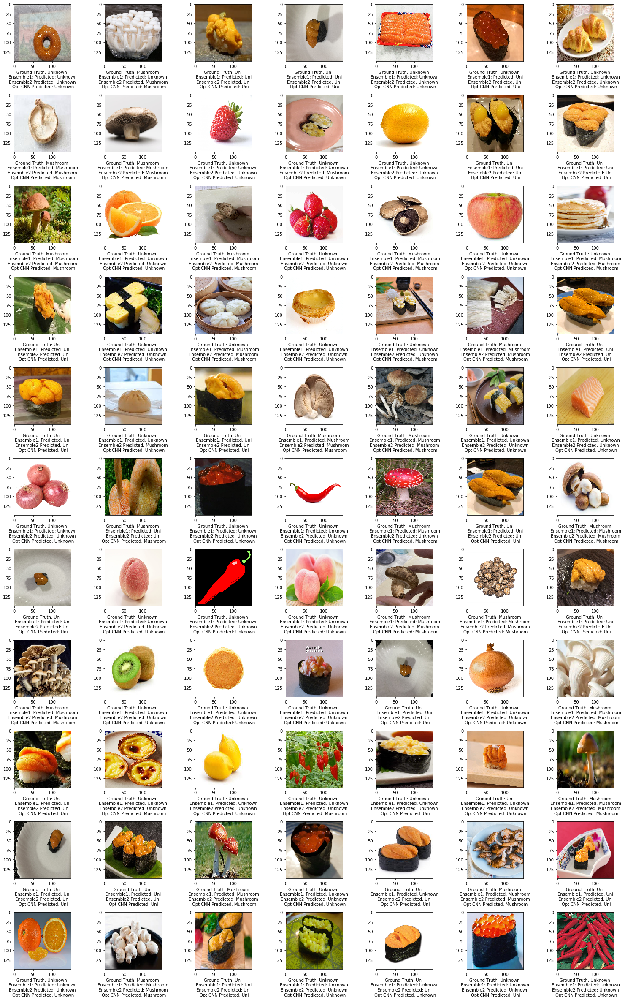

Ensemble1 CNN Model Structure and Hyperparamters
Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_12 (Conv2D)           (None, 148, 148, 64)      1792      
_________________________________________________________________
activation_17 (Activation)   (None, 148, 148, 64)      0         
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 74, 74, 64)        0         
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 72, 72, 64)        36928     
_________________________________________________________________
activation_18 (Activation)   (None, 72, 72, 64)        0         
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 36, 36, 64)        0         
_________________________________________________________________
dropo

NameError: name 'y_test_label' is not defined

In [29]:
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import Input, Average

def visualize_prediction():
    n = 77
    num_row, num_col = 11, 7
    fig, axes = plt.subplots(num_row, num_col, figsize=(3* num_col, 3* num_row))
    
    #Select Model for prediction
    cnn_1_predicted = ensemble_1.predict(test_batch)
    cnn_2_predicted = ensemble_2.predict(test_batch)
    cnn_opt_predictedd = cnn_optimal.predict(test_batch)
    
    for i in range(n):
        img = np.array(test_batch[0][i] * 255, dtype='uint8')
        ax = axes[i // num_col, i% num_col]
        
        #Ground Truth
        class_index = np.argmax(test_batch[1][i]) 
        class_index_truth = classes[class_index]
        
        #Ensemble_1 Model
        predicted_class_index_CNN1 = np.argmax(cnn_1_predicted[i])
        predicted_class_CNN1 = classes[predicted_class_index_CNN1]
        
        #Ensemble_2 Model
        predicted_class_index_CNN2 = np.argmax(cnn_2_predicted[i])
        predicted_class_CNN2 = classes[predicted_class_index_CNN2]
        
        #CNN Optimized Model
        predicted_class_index_ORG = np.argmax(cnn_opt_predictedd[i])
        predicted_class_ORG = classes[predicted_class_index_ORG]
        
        ax.set_xlabel(f'Ground Truth: {class_index_truth} \n Ensemble1: Predicted: {predicted_class_CNN1} \n Ensemble2 Predicted: {predicted_class_CNN2} \n Opt CNN Predicted: {predicted_class_ORG}')
        ax.imshow(img)
        
    plt.tight_layout()
    plt.show()
visualize_prediction()

print("Ensemble1 CNN Model Structure and Hyperparamters")
ensemble_1.summary()
y_cnn = ensemble_1.predict(test_batch)
y_cnn_predicted = [np.argmax(element) for element in y_cnn]
print("\n **************** Classification Report Ensemble Model 1 ****************\n\n", classification_report(y_test_label, y_cnn_predicted))
print("\n" ,cnn.evaluate(X_test, y_test), "\n")
print("*******************************************************************\n")

print("Ensemble2 CNN Model Structure and Hyperparamters")
ensemble_2.summary()
y_cnn = ensemble_2.predict(test_batch)
y_cnn_predicted = [np.argmax(element) for element in y_cnn]
print("\n **************** Classification Report Ensemble Model 2 ****************\n\n", classification_report(y_test_label, y_cnn_predicted))
print("\n" ,cnn.evaluate(X_test, y_test), "\n")
print("*******************************************************************\n")

In [31]:
ensemble_1.save("ensemble1_best.hdf5")
ensemble_2.save("ensemble2_best.hdf5")
cnn_optimal.save("opt_cnn_best.hdf5")

As the data suggests, these new models do not peform as well as the previous model. That is to be expected as there is less data, however each model has it strengths. This is where the ensemble method kicks in, lets combine all 3 models and take the most commonly predicted class as the final output.

# Step 4.5 Ensemble Learning Model

In [64]:
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import Input, Average, Maximum

model_1 = load_model("ensemble1_best.hdf5")
model_1 = Model(inputs=model_1.inputs,
                outputs=model_1.outputs,
                name='ensemble_model_1')

model_2 = load_model("ensemble2_best.hdf5")
model_2 = Model(inputs=model_2.inputs,
                outputs=model_2.outputs,
                name='ensemble_model_2')

model_3 = load_model("opt_cnn_best.hdf5")
model_3 = Model(inputs=model_3.inputs,
                outputs=model_3.outputs,
                name='ensemble_model_3')

model_4 = load_model("cnn_optimal.hdf5")
model_4 = Model(inputs=model_4.inputs,
                outputs=model_4.outputs,
                name='ensemble_model_4')

models = [model_1, model_2, model_3, model_4]
model_input = Input(shape=(150, 150, 3))
model_outputs = [model(model_input) for model in models]

#Obtain Average Output Output:
ensemble_output = Average()(model_outputs)

ensemble_model = Model(inputs=model_input, outputs=ensemble_output, name='ensemble')

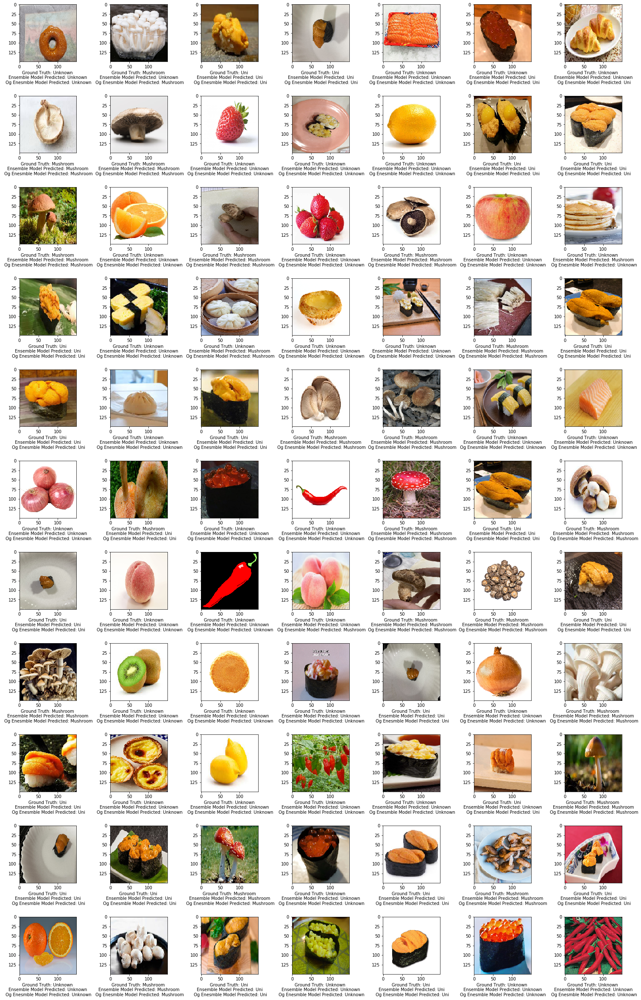

In [48]:
def visualize_prediction():
    n = 77
    num_row, num_col = 11, 7
    fig, axes = plt.subplots(num_row, num_col, figsize=(3* num_col, 3* num_row))
    
    #Select Model for prediction
    og_ensemble = load_model("ensemble_model.hdf5")
    og_ensemble_predicted = og_ensemble.predict(test_batch)
    ensemble_predicted = ensemble_model.predict(test_batch)
    
    for i in range(n):
        img = np.array(test_batch[0][i] * 255, dtype='uint8')
        ax = axes[i // num_col, i% num_col]
        
        #Ground Truth
        class_index = np.argmax(test_batch[1][i]) 
        class_index_truth = classes[class_index]
        
        #Ensemble Model
        predicted_class_index_ensemble = np.argmax(ensemble_predicted[i])
        predicted_class_ensemble = classes[predicted_class_index_ensemble]
        
        #Og Ensemble Model
        predicted_class_index_ensemble_og = np.argmax(og_ensemble_predicted[i])
        predicted_class_ensemble_og = classes[predicted_class_index_ensemble_og]        
        
        ax.set_xlabel(f'Ground Truth: {class_index_truth} \n Ensemble Model Predicted: {predicted_class_ensemble} \n Og Enesmble Model Predicted: {predicted_class_ensemble_og}' )
        ax.imshow(img)
        
    plt.tight_layout()
    plt.show()
visualize_prediction()

Looking at the resuts, its safe to conclude that it has been sucessfull. There was an onverall increase in accuracy and more bias has been reduced. Epic

In [46]:
ensemble_model.save("ensemble_model_latest.hdf5")